# Project Goal
I wanted to get my hands dirty with an industry standard toolbox for 2-photon image analysis and work with real data. Through this, I hope to show my proficiency with image analysis and python programming along with my willingness to approach problems head-on. I followed the official [CaImAn documentation](https://github.com/flatironinstitute/CaImAn.git) to perform this analysis, but had to adapt the code to my conditions.

In [1]:
import imageio.v2 as imageio
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
from bokeh.io import output_notebook

In [2]:
import caiman as cm
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import cnmf, params
from caiman.utils.utils import download_demo
from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
from visualization import nb_view_quilt

In [3]:
output_notebook()

Loading BokehJS ...

# Dataset Description
This data was collected using a 2-photon microscope  (B-scope; Thorlabs, USA). It shows GCaMP6f expression from the Retrosplenial cortex of 5 animals over 7 days. In this study, I will be working with data from the 7th day. The animal of interest was not indicated in the dataset's description.
[Sun, Weilun (2021), “In vivo two-photon calcium imaging dataset_Day 7”, Mendeley Data, V1, doi: 10.17632/hjgtsmyyv5.1](https://data.mendeley.com/datasets/hjgtsmyyv5/1)

In [4]:
num_animals = 5
num_frames = 1500

In [17]:
def build_image_dict(num_animals, num_frames): 
    image_dict = {}
    for i in range(1, num_animals + 1):
        path_name = f"./Animal_{i}"
        input_path = Path(path_name)
        image_list = sorted(input_path.glob("*.tif"), key=lambda x: f"{int(str(x.stem).split('_')[-1]):09}")
        images = []
        for im_path in tqdm(image_list[:num_frames]):
            images.append(imageio.imread(im_path))
        # Reshape into (Time x Height x Width).
        image_dict[f"Animal_{i}"] = np.dstack(images).reshape(-1, 256, 256)

    return image_dict

image_dict = build_image_dict(num_animals, num_frames)

100%|██████████████████████████████████████| 1500/1500 [00:02<00:00, 550.91it/s]


In [18]:
def write_movie(image_dict):   
    for animal in tqdm(image_dict.keys()):
        print(f"Writing {animal}_movie.tif...")
        imageio.mimwrite(f'{animal}_movie.tif', image_dict[animal], format='TIFF')

write_movie(image_dict)

  0%|                                                     | 0/5 [00:00<?, ?it/s]

Writing Animal_1_movie.tif...


 20%|█████████                                    | 1/5 [00:00<00:01,  2.76it/s]

Writing Animal_2_movie.tif...


 40%|██████████████████                           | 2/5 [00:00<00:01,  2.38it/s]

Writing Animal_3_movie.tif...


 60%|███████████████████████████                  | 3/5 [00:01<00:00,  2.27it/s]

Writing Animal_4_movie.tif...


 80%|████████████████████████████████████         | 4/5 [00:01<00:00,  2.32it/s]

Writing Animal_5_movie.tif...


100%|█████████████████████████████████████████████| 5/5 [00:02<00:00,  2.38it/s]


## Computing Baseline Data
### Max Projection
Looking at the maximum pixel values at each frame can generally indicate which neurons are activated at a given moment. However, before motion correction, these maximum intensity projections can be misleading due to motion artifacts. If the sample shifts between frames, the same neuron may appear in slightly different locations over time, causing blurring or spreading of high-intensity signals across multiple pixels. This results in a less distinct and noisier max projection image.
### Local Correlations
Local correlations are a measure of how well pixel intensities in neighboring regions of the image correlate over time. Before motion correction, this measure can be distorted by motion artifacts because moving neurons may cause nearby pixels to show temporal patterns that are not genuinely related to the same underlying neuronal activity. For example, a neuron might shift in position from one frame to the next, making its signal appear to "spread out" or correlate with adjacent pixels that don't actually share the same temporal dynamics.
### Expectations After Motion Correction
Using the NoRMCorre algorithm for motion correction, I expect to see: 
- Max Projection
    - the neuron locations more stabilized across frames, leading to a sharper, more defined max projection, where neuronal structures are more accurately represented without being smeared by motion-induced displacement.
- Local Correlations
    - reduced impact of false temporal correlations between pixels that are actually just displaced versions of the same neuron. Post-motion correction, pixels from neighboring regions should more accurately represent the same neural events over time, resulting in more reliable and precise local correlation maps. 

In [19]:
def get_baseline_movie_data(image_dict):
    max_projection_dict = {}
    correlation_image_dict = {}
    for animal in tqdm(image_dict.keys()):
        # Load data and reshape to (Time x Height x Width).
        movie_orig = imageio.mimread(f"{animal}_movie.tif", memtest=False)
        movie_orig = np.dstack(movie_orig).reshape(-1, 256, 256)
        
        # Calculate maximum fluorescence.
        max_projection_dict[animal] = movie_orig.max(axis=0)
        
        # Calculate local correlation.
        correlation_image_dict[animal] = cm.local_correlations(movie_orig, swap_dim=False)
        
        # Replace NaNs with zero.
        correlation_image_dict[animal][np.isnan(correlation_image_dict[animal])] = 0 
        
    return max_projection_dict, correlation_image_dict

max_projection_dict, correlation_image_dict = get_baseline_movie_data(image_dict)

100%|█████████████████████████████████████████████| 5/5 [00:25<00:00,  5.17s/it]


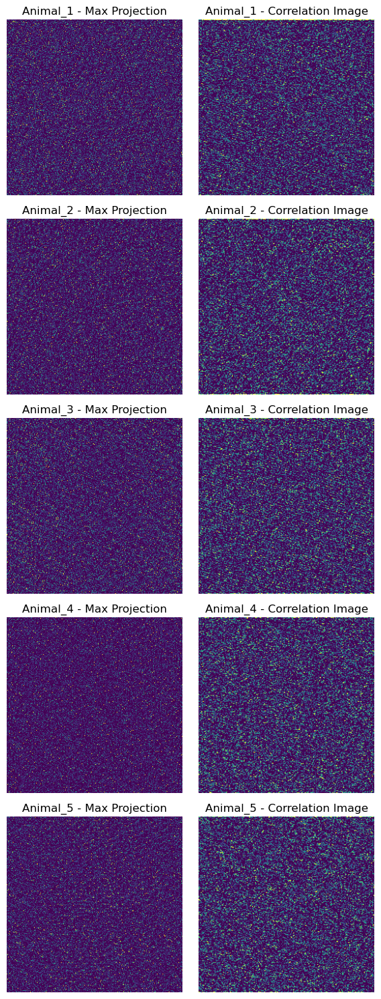

In [20]:
def plot_baseline_movie_data(max_projection_dict, correlation_image_dict):
    fig, axes = plt.subplots(len(max_projection_dict), 2, figsize=(6, 3 * len(max_projection_dict)))
    
    if len(max_projection_dict) == 1:
        axes = [axes]

    for i, (animal, max_projection) in enumerate(max_projection_dict.items()):
        correlation_image = correlation_image_dict[animal]
        
        # Plot Max Projection.
        ax_max = axes[i][0]
        ax_max.imshow(max_projection, cmap='viridis',
                      vmin=np.percentile(max_projection.ravel(), 50), 
                      vmax=np.percentile(max_projection.ravel(), 99.5))
        ax_max.set_title(f"{animal} - Max Projection", fontsize=12)
        ax_max.axis("off")

        # Plot Correlation Image.
        ax_corr = axes[i][1]
        ax_corr.imshow(correlation_image, cmap='viridis',
                       vmin=np.percentile(correlation_image.ravel(), 50), 
                       vmax=np.percentile(correlation_image.ravel(), 99.5))
        ax_corr.set_title(f"{animal} - Correlation Image", fontsize=12)
        ax_corr.axis("off")

    # Adjust layout for better visualization.
    plt.tight_layout()
    plt.show()
    
plot_baseline_movie_data(max_projection_dict, correlation_image_dict)

## Analysis Parameters
### Dataset-dependent Parameters
__- fr__: Frame rate of imaging = 14.7 Hz 

__- decay_time__: Decay time of GCaMP6f = 0.4 s

__- dxy__: Spatial resolution per pixel in um = 300/256 um/pixel

### Motion Correction Parameters
__- strides__: Size of each region (patch) for piecewise rigid motion correction = (48, 48) pixels

__- overlaps__: Size of common region between patches: (24, 24) pixels

__- max_shifts__: Maximum shift-distance allowed for motion correction = (6, 6) pixels

__- max_deviation_rigid__: Maximum difference between patch shift and shift of whole image = 3 pixels

__- pw_rigid__: Enables algorithm to shift patches independently while maintaining a rigid transformation within each patch = True

### CNMF parameters
__- p__: Order of model for for linearly dependent deconvolution = 1

__- gnb__: Number of background components for the algorithm to account for (i.e. fluroescence from tissue that is not actively being imaged) = 2

__- merge_thr__: Two components are merged if they have a correlation greater than this threshold as they are likely to be part of the same neuron = 0.85

__- bas_nonneg__: Prevents model from fitting negative_values because they would be biologically unrealistic = True

__- rf__: Sets patch size = 15

__- stride_cnmf__: Set to approximate size of neuron. Controls overlap between patches = 10

__- K__: Approximate number of components per patch. Lower values of K correspond to lower false-negative readings at the cost of efficiency = 4

__- gSig__: Set to roughly half the approximate size of a neuron. Parameter for Gaussian Blur = [4, 4]

__- gSiz__: uses gSig to calculate kernel size for Gaussian Blur

__- method_init__: Focuses the algorithm on the regions of interest with higher fluorescence to optimize efficiency = 'greedy_roi'

__- ssub__: Lower values correspond to higher resolution at the cost of efficiency = 1

__- tsub__: Controls downsampling of temporal resolution = 1

### Component Evaluation
__- min_SNR__: Minimum signal to noise ratio to accept a component = 2.0

__- rval_thr__: Threshold for spatial correlation between component and input data = 0.85

__- cnn_thr__: Threshold at the convolutional neural network accepts components = 0.99 

__- cnn_lowert__: Lowest probability for a component to be accepted by the convolutional neural network. Lowers chances of false-positive = 0.1

In [21]:
# general dataset-dependent parameters
fr = 15                     # imaging rate in frames per second
decay_time = 0.4            # length of a typical transient in seconds
dxy = (300/256, 300/256)              # spatial resolution in x and y in (um per pixel)

# motion correction parameters
strides = (48,48)          # start a new patch for pw-rigid motion correction every x pixels
overlaps = (24, 24)         # overlap between patches (width of patch = strides+overlaps)
max_shifts = (6, 6)          # maximum allowed rigid shifts (in pixels)
max_deviation_rigid = 3     # maximum shifts deviation allowed for patch with respect to rigid shifts
pw_rigid = True             # flag for performing non-rigid motion correction

# CNMF parameters for source extraction and deconvolution
p = 1                       # order of the autoregressive system (set p=2 if there is visible rise time in data)
gnb = 2                     # number of global background components (set to 1 or 2)
merge_thr = 0.85            # merging threshold, max correlation allowed
bas_nonneg = True           # enforce nonnegativity constraint on calcium traces (technically on baseline)
rf = 15                     # half-size of the patches in pixels (patch width is rf*2 + 1)
stride_cnmf = 10             # amount of overlap between the patches in pixels (overlap is stride_cnmf+1) 
K = 4                       # number of components per patch
gSig = np.array([4, 4])     # expected half-width of neurons in pixels (Gaussian kernel standard deviation)
gSiz = 2*gSig + 1           # Gaussian kernel width and hight
method_init = 'greedy_roi'  # initialization method (if analyzing dendritic data see demo_dendritic.ipynb)
ssub = 1                    # spatial subsampling during initialization 
tsub = 1                    # temporal subsampling during intialization

# parameters for component evaluation
min_SNR = 2.0               # signal to noise ratio for accepting a component
rval_thr = 0.85             # space correlation threshold for accepting a component
cnn_thr = 0.99              # threshold for CNN based classifier
cnn_lowest = 0.1            # neurons with cnn probability lower than this value are rejected

In [22]:
def build_parameter_dict(num_animals):
    # Assuming animals are labeled as 1 - num_animals.
    animal_ids = range(1, num_animals + 1)
    
    parameters_dict = {}
    for animal_id in animal_ids:
        animal = f'Animal_{animal_id}'
        movie_path = f'{animal}_movie.tif'

        parameter_dict = {
            'fnames': movie_path,
            'fr': fr,
            'dxy': dxy,
            'decay_time': decay_time,
            'strides': strides,
            'overlaps': overlaps,
            'max_shifts': max_shifts,
            'max_deviation_rigid': max_deviation_rigid,
            'pw_rigid': pw_rigid,
            'p': p,
            'nb': gnb,
            'rf': rf,
            'K': K, 
            'gSig': gSig,
            'gSiz': gSiz,
            'stride': stride_cnmf,
            'method_init': method_init,
            'rolling_sum': True,
            'only_init': True,
            'ssub': ssub,
            'tsub': tsub,
            'merge_thr': merge_thr, 
            'bas_nonneg': bas_nonneg,
            'min_SNR': min_SNR,
            'rval_thr': rval_thr,
            'use_cnn': False,
            'min_cnn_thr': cnn_thr,
            'cnn_lowest': cnn_lowest,
        }

        parameters = params.CNMFParams(params_dict=parameter_dict)
        parameters_dict[animal] = parameters
        
    return parameters_dict

parameters_dict = build_parameter_dict(num_animals=num_animals)

In setting CNMFParams, non-pathed parameters were used; this is deprecated. In some future version of Caiman, allow_legacy will default to False (and eventually will be removed)
In setting CNMFParams, non-pathed parameters were used; this is deprecated. In some future version of Caiman, allow_legacy will default to False (and eventually will be removed)
In setting CNMFParams, non-pathed parameters were used; this is deprecated. In some future version of Caiman, allow_legacy will default to False (and eventually will be removed)
In setting CNMFParams, non-pathed parameters were used; this is deprecated. In some future version of Caiman, allow_legacy will default to False (and eventually will be removed)
In setting CNMFParams, non-pathed parameters were used; this is deprecated. In some future version of Caiman, allow_legacy will default to False (and eventually will be removed)


## Motion Correction
### Why is Motion Correctio Necessary?
Motion correction helps eliminate the effects of slight movement that may cause artificats in the image in order to maintain spatial consistency. This allows us to improve the signal to noise ratio in the data and accurately extract components in CNMF. Although measures like head-fixing and anesthetization are generally used to minimize movement and in turn artificats, motion correction is still necessary to more closely represent accurate calcium expression.
### Why NoRMCorre?
Although there are computational benefits to rigid motion correction, NoRMCorre accounts for complex motion types that are more characteristic of living organisms as opposed to the more linear expectation of rigid motion correction, thus improving the alignment.

In [23]:
%%time
def build_motion_correct_dict(parameters_dict):
    motion_correct_dict = {}
    for parameter in tqdm(parameters_dict.keys()):
        mot_correct = MotionCorrect(parameters_dict[parameter].data['fnames'][0], \
                                    **parameters_dict[parameter].motion)
        
        # Perform the motion correction and save memory mapped file.
        mot_correct.motion_correct(save_movie=True)  
        motion_correct_dict[parameter] = mot_correct
        
    return motion_correct_dict

motion_correct_dict = build_motion_correct_dict(parameters_dict)

100%|█████████████████████████████████████████████| 5/5 [06:48<00:00, 81.79s/it]

CPU times: user 5min 57s, sys: 44.1 s, total: 6min 42s
Wall time: 6min 48s


In [24]:
def load_motion_corrected_movies(motion_correct_dict):
    movie_motion_correct_dict = {}
    for movie in tqdm(motion_correct_dict.keys()): 
        # Load motion corrected movie.
        movie_motion_corrected = cm.load(motion_correct_dict[movie].mmap_file)
        
        # Set lower bound to 0 to handle negative outliers from background subtraction.
        movie_motion_corrected = np.clip(movie_motion_corrected, a_min=0, a_max=2**31-1)
        movie_motion_correct_dict[movie] = movie_motion_corrected
    
    return movie_motion_correct_dict

movie_motion_correct_dict = load_motion_corrected_movies(motion_correct_dict)

  0%|                                                     | 0/5 [00:00<?, ?it/s]
%|                                                     | 0/1 [00:00<?, ?it/s]
 20%|█████████                                    | 1/5 [00:01<00:05,  1.39s/it]
%|                                                     | 0/1 [00:00<?, ?it/s]
 40%|██████████████████                           | 2/5 [00:02<00:03,  1.17s/it]
%|                                                     | 0/1 [00:00<?, ?it/s]
 60%|███████████████████████████                  | 3/5 [00:03<00:02,  1.10s/it]
%|                                                     | 0/1 [00:00<?, ?it/s]
 80%|████████████████████████████████████         | 4/5 [00:04<00:01,  1.09s/it]
%|                                                     | 0/1 [00:00<?, ?it/s]
100%|█████████████████████████████████████████████| 5/5 [00:05<00:00,  1.12s/it]


## Motion Correction Comparison Study
See analysis below

In [25]:
# Calculate maximum fluorescence and local correlations for motion corrected data.
max_projection_mc_dict, correlation_image_mc_dict = get_baseline_movie_data(movie_motion_correct_dict)

100%|█████████████████████████████████████████████| 5/5 [00:25<00:00,  5.10s/it]


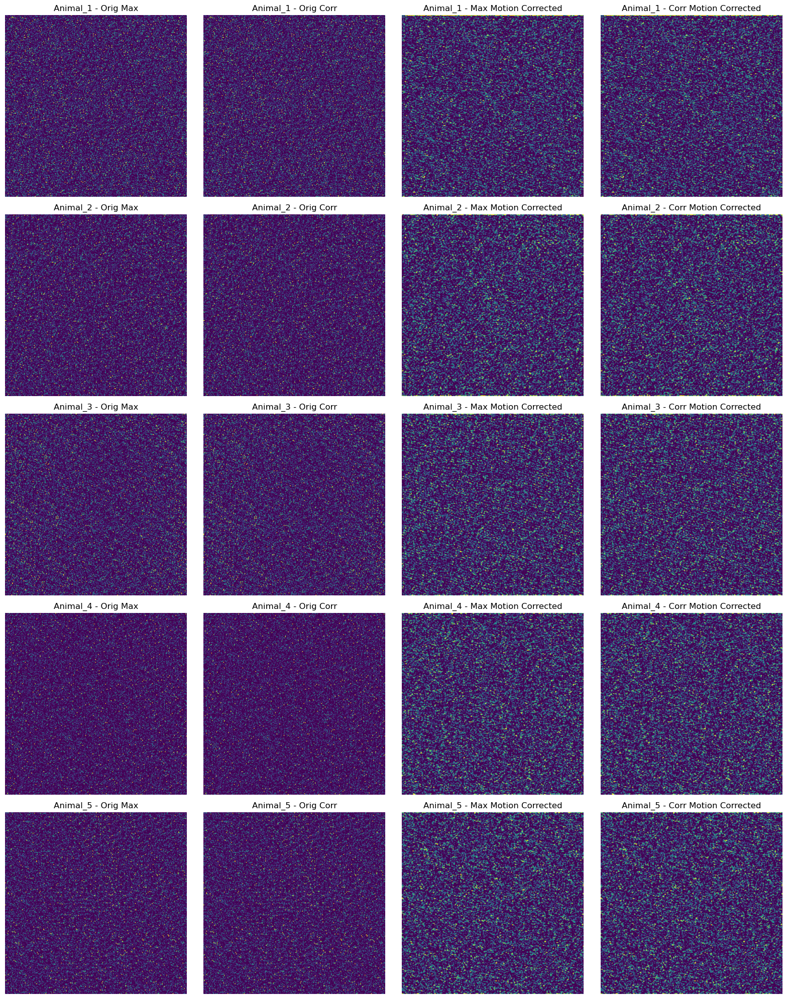

In [26]:
def compare_baseline_data(max_projection_dict, correlation_image_dict, \
                          max_projection_mc_dict, correlation_image_mc_dict):
    fig, axes = plt.subplots(num_animals, 4, figsize=(16, 4 * num_animals))
    axes = np.atleast_2d(axes)

    for i, animal in enumerate(max_projection_dict.keys()):
        # Get data before motion correction.
        max_orig = max_projection_dict[animal]
        corr_orig = correlation_image_dict[animal]

        # Get motion corrected data.
        max_corr = max_projection_mc_dict[animal]
        corr_corr = correlation_image_mc_dict[animal]

        # Plot Original Max Projection
        ax = axes[i, 0]
        ax.imshow(max_orig, cmap='viridis', 
                  vmin=np.percentile(max_orig.ravel(), 50), 
                  vmax=np.percentile(max_orig.ravel(), 99.5))
        ax.set_title(f"{animal} - Orig Max", fontsize=12)
        ax.axis("off")

        # Plot Corrected Max Projection
        ax = axes[i, 1]
        ax.imshow(max_corr, cmap='viridis', 
                  vmin=np.percentile(max_corr.ravel(), 50), 
                  vmax=np.percentile(max_corr.ravel(), 99.5))
        ax.set_title(f"{animal} - Orig Corr", fontsize=12)
        ax.axis("off")

        # Plot Original Correlation Image
        ax = axes[i, 2]
        ax.imshow(corr_orig, cmap='viridis', 
                  vmin=np.percentile(corr_orig.ravel(), 50), 
                  vmax=np.percentile(corr_orig.ravel(), 99.5))
        ax.set_title(f"{animal} - Max Motion Corrected", fontsize=12)
        ax.axis("off")

        # Plot Corrected Correlation Image
        ax = axes[i, 3]
        ax.imshow(corr_corr, cmap='viridis', 
                  vmin=np.percentile(corr_corr.ravel(), 50), 
                  vmax=np.percentile(corr_corr.ravel(), 99.5))
        ax.set_title(f"{animal} - Corr Motion Corrected", fontsize=12)
        ax.axis("off")

    plt.tight_layout()
    plt.show()
    
compare_baseline_data(max_projection_dict, correlation_image_dict, \
                      max_projection_mc_dict, correlation_image_mc_dict)

## Motion Correction Comparison Study Analysis
Before motion correction, the image appears smoother and less detailed, with fluorescence signals appearing in transient, less defined bursts. This is likely due to the misalignment of frames, causing neural signals to blur across time and space. Additionally, motion artifacts may obscure finer structures, leading to a loss of spatial resolution and reducing the ability to distinguish individual components.

After motion correction, the image becomes significantly more granular, meaning that fluorescence signals are more localized and well-defined. This suggests that neural activity is now more accurately captured, with individual neurons and their fluctuations more clearly separated from background noise. The increased fluorescence intensity across the image indicates that signal integration is no longer disrupted by motion artifacts, leading to a more faithful representation of neural activity.

This improvement is significant because motion artifacts can obscure true neural signals, making it difficult to accurately track activity, quantify fluorescence changes, or extract meaningful neuronal dynamics. By enhancing spatial precision and preserving the integrity of fluorescence fluctuations, motion correction ensures that downstream analyses—such as source extraction, spike inference, and functional connectivity studies—are based on more reliable data.

## Constrained Non-Negative Matrix Factorization (CNMF)
Constrained Non-Negative Matrix Factorization, or CNMF, is often used for 2-photon image analysis. It operates by decomposing the fluorescence signals into spatial and temporal components that correspond to individual neuronal activity. 

Unlike PCA or ICA, CNMF handles the problem of overlapping neurons well by explicitly modeling the spatial overlap of neurons. By enforcing non-negativity, it further improves the robustness of the extracted signals, modeling true biological behavior. Additionally, it can build upon motion correction by identifying stable neural components, filtering out motion-induced changes in intensity. 

### What to expect from this data?
After performing CNMF on the 2-photon data, I expect to be able to visualize distinct spatial components mapping to neurons. The algoritm should account for overlapping signals and return the isolated neurons accordingly. There should be very little background fluorescence due to CNMF's explicit separation of signals into their Spatial, Temporal, and Background components. Lastly, I hope to be able to isolate certain spikes in the neurons and attribute those spikes to specific function.

In [27]:
def build_cnmf_model_dict(parameters_dict):
    cnmf_model_dict = {}
    
    for animal in tqdm(parameters_dict):
        cnmf_model = cnmf.CNMF(1,params=parameters_dict[animal])
        cnmf_model_dict[animal] = cnmf_model
        
    return cnmf_model_dict

cnmf_model_dict = build_cnmf_model_dict(parameters_dict)

100%|██████████████████████████████████████████| 5/5 [00:00<00:00, 16131.94it/s]


In [38]:
def build_processed_images_dict(motion_correct_dict):
    processed_images_dict = {}
    for i, motion_corrected_movie in enumerate(tqdm(motion_correct_dict)):
        mc_memmapped_fname = cm.save_memmap(
            motion_correct_dict[motion_corrected_movie].mmap_file, 
            base_name=f'memmap_{i}_', 
            order='C',
            border_to_0=0
        )

        # Load the memmapped file.
        raw_calcium_traces, dims, num_frames = cm.load_memmap(mc_memmapped_fname)

        # Reshape into Time x Height x Width.
        images = np.reshape(raw_calcium_traces.T, [num_frames] + list(dims), order='F')
        
        processed_images_dict[motion_corrected_movie] = images
        
    return processed_images_dict

processed_images_dict = build_processed_images_dict(motion_correct_dict)

100%|█████████████████████████████████████████████| 5/5 [00:05<00:00,  1.02s/it]


In [39]:
%%time
def build_cnmf_dict(cnmf_model_dict, processed_images_dict, cnmf_refit_dict=None):
    cnmf_fit_dict = {}
    for animal in tqdm(processed_images_dict.keys()):
        # Perform refinement on initial fit if already computed.
        if cnmf_refit_dict is not None:
            cnmf_fit = cnmf_refit_dict[animal].refit(processed_images_dict[animal])
        else:
            cnmf_fit = cnmf_model_dict[animal].fit(processed_images_dict[animal])

        cnmf_fit_dict[animal] = cnmf_fit
        
    return cnmf_fit_dict

cnmf_fit_dict = build_cnmf_dict(cnmf_model_dict, processed_images_dict)

/opt/anaconda3/envs/caiman_env/lib/python3.10/site-packages/caiman/source_extraction/cnmf/deconvolution.py:1004: FutureWarning: Beginning in SciPy 1.17, multidimensional input will be treated as a batch, not `ravel`ed. To preserve the existing behavior and silence this warning, `ravel` arguments before passing them to `toeplitz`.
  A = scipy.linalg.toeplitz(xc[lags + np.arange(lags)],
/opt/anaconda3/envs/caiman_env/lib/python3.10/site-packages/caiman/source_extraction/cnmf/deconvolution.py:1004: FutureWarning: Beginning in SciPy 1.17, multidimensional input will be treated as a batch, not `ravel`ed. To preserve the existing behavior and silence this warning, `ravel` arguments before passing them to `toeplitz`.
  A = scipy.linalg.toeplitz(xc[lags + np.arange(lags)],
/opt/anaconda3/envs/caiman_env/lib/python3.10/site-packages/caiman/source_extraction/cnmf/deconvolution.py:1004: FutureWarning: Beginning in SciPy 1.17, multidimensional input will be treated as a batch, not `ravel`ed. To pr

CPU times: user 8min 11s, sys: 4.75 s, total: 8min 16s
Wall time: 8min 23s


## CNMF Initial Fit Visualization
The initial segmentation does not seem to have yielded the results I was looking for. There is significant overlap between neurons, and the signal to noise ratio seems to be relatively high, as seen in the plots below. The distribution of neurons must be more discrete in order for the signal separation to yield any significant results.

In [40]:
def plot_cnmf_contours(cnmf_fit_dict, correlation_image_mc_dict, evaluated=False):
    for animal in tqdm(cnmf_fit_dict.keys()):
        cnmf_fit = cnmf_fit_dict[animal]
        correlation_image = correlation_image_mc_dict[animal]
        if evaluated:
            cnmf_fit.estimates.plot_contours_nb(img=correlation_image, \
                                                idx=cnmf_fit.estimates.idx_components)
        else:         
            cnmf_fit.estimates.plot_contours_nb(img=correlation_image)

plot_cnmf_contours(cnmf_fit_dict, correlation_image_mc_dict)

100%|█████████████████████████████████████████████| 5/5 [00:01<00:00,  2.50it/s]


## CNMF Re-Fit
To improve the accuracy of neural signal extraction, I performed a CNMF re-fit after the initial decomposition. The first pass can sometimes lead to overlapping components, missed low-amplitude signals, or insufficient separation of neural and background activity. Re-fitting allows for a more precise refinement of spatial components and calcium traces, enhancing signal quality and reducing background noise. This step ensures a more reliable representation of neural activity, improving the robustness of downstream analyses.

In [41]:
%%time
cnmf_refit_dict = build_cnmf_dict(cnmf_model_dict, processed_images_dict, cnmf_fit_dict)

/opt/anaconda3/envs/caiman_env/lib/python3.10/site-packages/caiman/source_extraction/cnmf/deconvolution.py:1004: FutureWarning: Beginning in SciPy 1.17, multidimensional input will be treated as a batch, not `ravel`ed. To preserve the existing behavior and silence this warning, `ravel` arguments before passing them to `toeplitz`.
  A = scipy.linalg.toeplitz(xc[lags + np.arange(lags)],
/opt/anaconda3/envs/caiman_env/lib/python3.10/site-packages/caiman/source_extraction/cnmf/deconvolution.py:1004: FutureWarning: Beginning in SciPy 1.17, multidimensional input will be treated as a batch, not `ravel`ed. To preserve the existing behavior and silence this warning, `ravel` arguments before passing them to `toeplitz`.
  A = scipy.linalg.toeplitz(xc[lags + np.arange(lags)],
/opt/anaconda3/envs/caiman_env/lib/python3.10/site-packages/caiman/source_extraction/cnmf/deconvolution.py:1004: FutureWarning: Beginning in SciPy 1.17, multidimensional input will be treated as a batch, not `ravel`ed. To pr

CPU times: user 3min 40s, sys: 3.21 s, total: 3min 44s
Wall time: 3min 45s


In [42]:
plot_cnmf_contours(cnmf_refit_dict, correlation_image_mc_dict)

100%|█████████████████████████████████████████████| 5/5 [00:02<00:00,  2.42it/s]


In [43]:
for animal in cnmf_refit_dict.keys():
    print(f"{cnmf_refit_dict[animal].estimates.A.shape[1]} components found in {animal}.")

28 components found in Animal_1.
33 components found in Animal_2.
20 components found in Animal_3.
62 components found in Animal_4.
35 components found in Animal_5.


## Evaluation
While the CNMF approach showed promising results in terms of low false-positive readings across all animals, Animals 2, 3, and 4 presented challenges with very few identifiable components. The poor SNR in these cases was primarily due to low signal strength, making it difficult to distinguish neural activity from background noise, despite the low false-positive rate. In contrast, Animals 1 and 5 demonstrated more promising results with higher SNR, as they exhibited clearer and more discrete neuronal activity, enabling more reliable segmentation and separation of individual neurons.

Although I considered employing CNN-based algorithms for better signal discrimination, limited computational resources led me to prioritize the CNMF approach. This decision was made with the understanding that CNN models could significantly improve segmentation by more accurately distinguishing neural signals from noise in more complex data sets. 

In [44]:
def evaluate_components(processed_images_dict, cnmf_refit_dict):
    for animal in processed_images_dict.keys():
        processed_images = processed_images_dict[animal]
        cnmf_refit = cnmf_refit_dict[animal]
        cnmf_refit.estimates.evaluate_components(processed_images, cnmf_refit.params);
        print(f"Num accepted/rejected: {len(cnmf_refit.estimates.idx_components)}, {len(cnmf_refit.estimates.idx_components_bad)}")
        
evaluate_components(processed_images_dict, cnmf_refit_dict)


Component 5 is only active jointly with neighboring components. Space correlation calculation might be unreliable.


Num accepted/rejected: 4, 24
Num accepted/rejected: 10, 23


Component 1 is only active jointly with neighboring components. Space correlation calculation might be unreliable.
Component 28 is only active jointly with neighboring components. Space correlation calculation might be unreliable.


Num accepted/rejected: 0, 20
Num accepted/rejected: 16, 46
Num accepted/rejected: 25, 10


In [45]:
plot_cnmf_contours(cnmf_refit_dict, correlation_image_mc_dict, evaluated=True)

100%|█████████████████████████████████████████████| 5/5 [00:02<00:00,  1.74it/s]


## Segmentation vs Signal Extraction
Both segmentation and signal extraction are important aspects of 2-photon image analysis. My understanding of their difference is mainly in theri scale and focus. Segmentation looks to identify possible regions of interest in the imaging field. This involves grouping pixels that may belong to the same neuron, and in turn separating them from background fluorescence and overlapping signals. Signal extraction on the other hand works to isolate the fluorescence activity of each segmented neuron over time. This process converts the raw imaging data into time-series calcium signals whcih can then be analyzed to assess neural activity. 

These two processess work hand-in-hand. Segmentation must be accurate and significant in order for the extraction to yield positive result. A well segmented dataset ensures that the extracted signals accurately represent the neural activity of the subjects being imaged.

In [48]:
def plot_components(cnmf_refit_dict, correlation_image_dict, bad_components=False):
    for animal in cnmf_refit_dict.keys():
        cnmf_refit = cnmf_refit_dict[animal]
        correlation_image = correlation_image_dict[animal]
        if bad_components:
            # View rejected components.
            if len(cnmf_refit.estimates.idx_components_bad) > 0:
                cnmf_refit.estimates.nb_view_components(img=correlation_image, 
                                                        idx=cnmf_refit.estimates.idx_components_bad, 
                                                        cmap='gray',
                                                        denoised_color='red')
            else:
                print("No components were rejected.")
        else:
            # View accepted components.
            if len(cnmf_refit.estimates.idx_components) > 0:
                cnmf_refit.estimates.nb_view_components(img=correlation_image, 
                                            idx=cnmf_refit.estimates.idx_components,
                                            cmap='gray');
            
            else:
                print("No components were accepted.")
            
plot_components(cnmf_refit_dict, correlation_image_dict)

AttributeError: 'Estimates' object has no attribute 'idx_components_good'

In [37]:
plot_components(cnmf_refit_dict, correlation_image_dict, bad_components=True)

## Error Sources and Further Analysis
There are many unknowns with the dataset I chose. Although the conditions and specifications by which the animals were imaged are mentioned in the description of the data, the exact experimental conditions were not. Due to this, there can be many sources of error ranging from animal movement to fluorescence bleaching. 

However, a possible source of error in my analysis was in the setting of the CNMF parameters. Although these are based on both the original documentation for CaImAn's CNMF walkthrough and the specifications provided in the description of the dataset, many of the parameters are variable (i.e. rf, stride_cnmf etc.). 

If I were to perform this analysis again, I would focus on refining the parameters to optimize the final signal extraction. 